In [23]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster import hierarchy as hclust
from scipy.stats.mstats import winsorize
from scipy import stats 
from statsmodels.graphics.tsaplots import plot_acf

import statsmodels.api as sm
import statsmodels.formula.api as smf

from help_funcs import OLSAR1
import importlib
import sys

In [24]:
labeled_data = pd.read_csv('Данные/processed/regression-data-v0.csv')
labeled_data.head()

,Код раздела,Название раздела,ROFA,K,L,t
0,A,"Сельское, лесное хозяйство, охота, рыболовство...",0.033481,9966787,1.302680e+08,2017
1,A,"Сельское, лесное хозяйство, охота, рыболовство...",0.030218,11231579,1.416755e+08,2018
2,A,"Сельское, лесное хозяйство, охота, рыболовство...",0.031950,10989834,1.516897e+08,2019
3,A,"Сельское, лесное хозяйство, охота, рыболовство...",0.028979,12137603,1.583287e+08,2020
4,A,"Сельское, лесное хозяйство, охота, рыболовство...",0.024977,13966128,1.770949e+08,2021


C:\Users\brazen\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


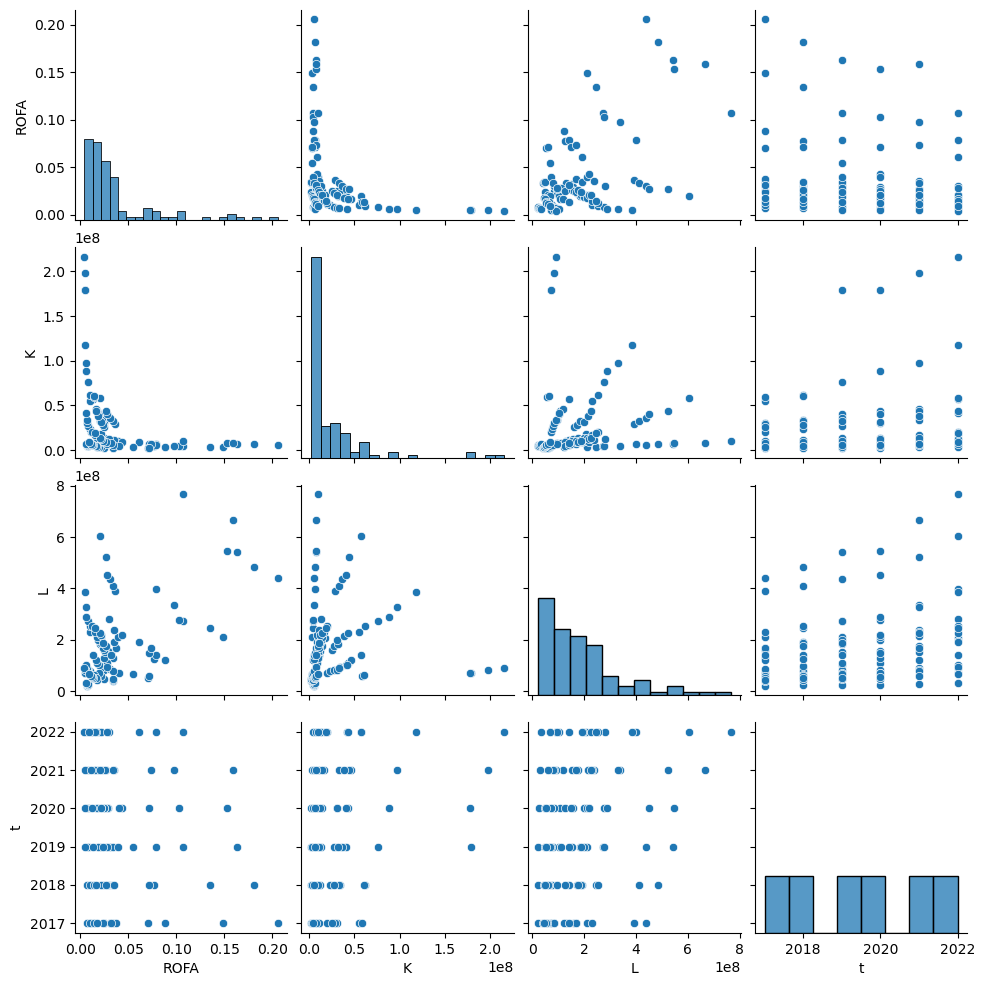

In [25]:
sns.pairplot(labeled_data, )

C:\Users\brazen\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


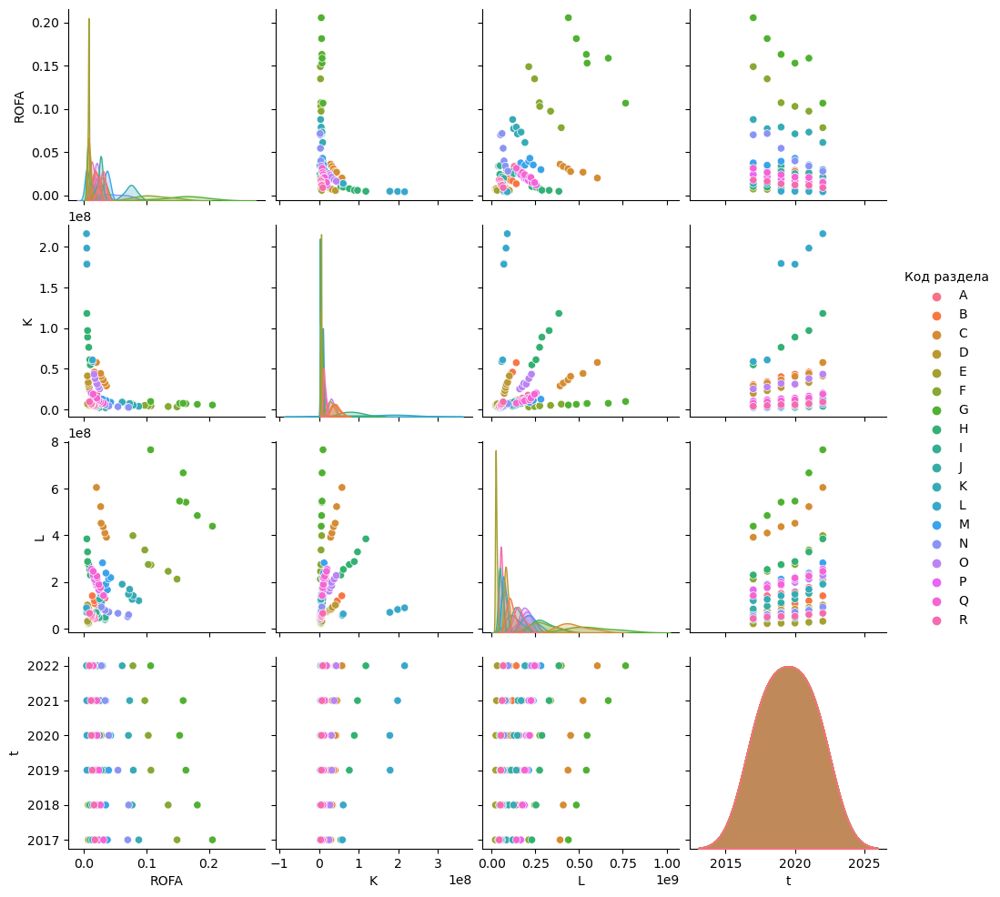

In [26]:
sns.pairplot(labeled_data, hue="Код раздела")

<Axes: >

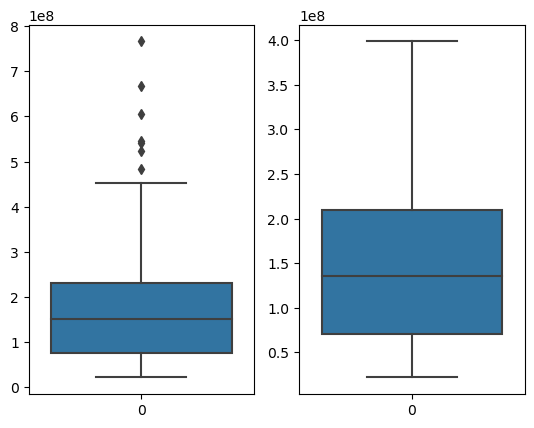

In [27]:
fig, axs = plt.subplots(ncols=2)
sns.boxplot(labeled_data["L"], ax=axs[0])
# data_cleared = labeled_data["L"][labeled_data["L"] < 4.2*10**8]
# data_cleared = labeled_data.copy()
# data_cleared["L"] = winsorize(labeled_data["L"], limits=(0, 0.1))
data_cleared = labeled_data[~labeled_data['Код раздела'].isin(['C', 'G'])]
sns.boxplot(data_cleared["L"], ax=axs[1])

In [28]:
labeled_data[labeled_data["L"] > 4.2*10**8]

,Код раздела,Название раздела,ROFA,K,L,t
14,C,Обрабатывающие производства,0.030713,36410867,4.369142e+08,2019
15,C,Обрабатывающие производства,0.027510,40706473,4.517749e+08,2020
16,C,Обрабатывающие производства,0.026798,44287464,5.227543e+08,2021
17,C,Обрабатывающие производства,0.020012,57834822,6.045925e+08,2022
36,G,Торговля оптовая и розничная; ремонт автотранс...,0.205532,5560072,4.392083e+08,2017
37,G,Торговля оптовая и розничная; ремонт автотранс...,0.181353,6396563,4.845159e+08,2018
38,G,Торговля оптовая и розничная; ремонт автотранс...,0.163049,7131169,5.417251e+08,2019
39,G,Торговля оптовая и розничная; ремонт автотранс...,0.153015,7498777,5.461843e+08,2020
40,G,Торговля оптовая и розничная; ремонт автотранс...,0.158686,7655289,6.669613e+08,2021
41,G,Торговля оптовая и розничная; ремонт автотранс...,0.106684,9941001,7.659713e+08,2022


<Axes: >

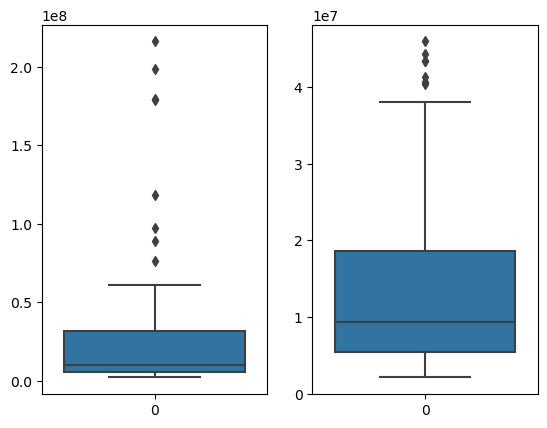

In [29]:
fig, axs = plt.subplots(ncols=2)
sns.boxplot(labeled_data["K"], ax=axs[0])
# data_cleared = labeled_data["K"][labeled_data["L"] < 4.2*10**8]
# data_cleared = labeled_data.copy()
# data_cleared["K"] = winsorize(labeled_data["L"], limits=(0, 0.1))
# data_cleared = labeled_data[~labeled_data['Код раздела'].isin(['H', 'L'])]
data_cleared = labeled_data[labeled_data["K"] <= 0.5*10**8]
sns.boxplot(data_cleared["K"], ax=axs[1])

In [30]:
labeled_data[labeled_data["K"] > 0.5*10**8]

,Код раздела,Название раздела,ROFA,K,L,t
11,B,Добыча полезных ископаемых,0.013401,57493750,1.413998e+08,2022
17,C,Обрабатывающие производства,0.020012,57834822,6.045925e+08,2022
42,H,Транспортировка и хранение,0.010247,54899257,2.304036e+08,2017
43,H,Транспортировка и хранение,0.009466,61247494,2.541331e+08,2018
44,H,Транспортировка и хранение,0.007714,76419015,2.748786e+08,2019
45,H,Транспортировка и хранение,0.005909,88904004,2.879935e+08,2020
46,H,Транспортировка и хранение,0.005825,97039696,3.291459e+08,2021
47,H,Транспортировка и хранение,0.004702,118068658,3.848886e+08,2022
66,L,Деятельность по операциям с недвижимым имуществом,0.013732,58995304,5.841944e+07,2017
67,L,Деятельность по операциям с недвижимым имуществом,0.013748,60900348,6.377901e+07,2018


<Axes: >

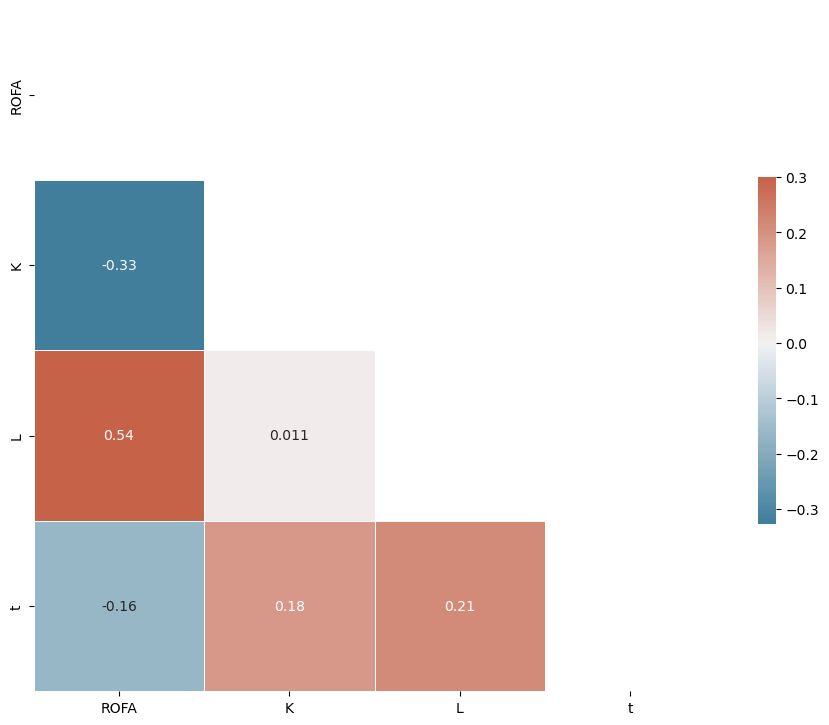

In [31]:
data = labeled_data.iloc[:, 2:]
# Compute the correlation matrix
corr = data.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, annot=True, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [32]:
data.iloc[:, :-1] = data.iloc[:, :-1].apply(lambda x: np.log(x))
data = data.rename(columns={"ROFA": "ln_ROFA", "K": "ln_K", "L": "ln_L"})
data.head()

,ln_ROFA,ln_K,ln_L,t
0,-3.396789,16.114769,18.685104,2017
1,-3.499328,16.234240,18.769050,2018
2,-3.443596,16.212481,18.837347,2019
3,-3.541173,16.311819,18.880184,2020
4,-3.689788,16.452146,18.992196,2021


In [33]:
X = data.iloc[:, 1:]
X = sm.add_constant(X)
X.head()

,const,ln_K,ln_L,t
0,1.0,16.114769,18.685104,2017
1,1.0,16.234240,18.769050,2018
2,1.0,16.212481,18.837347,2019
3,1.0,16.311819,18.880184,2020
4,1.0,16.452146,18.992196,2021


In [34]:
Y = data.loc[:, "ln_ROFA"]
Y.head()

0   -3.396789
1   -3.499328
2   -3.443596
3   -3.541173
4   -3.689788
Name: ln_ROFA, dtype: float64

In [35]:
regression = sm.OLS(Y, X, hasconst=True)
result_OLS = regression.fit()
result_OLS.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                ln_ROFA   R-squared:                       0.792
Model:                            OLS   Adj. R-squared:                  0.786
Method:                 Least Squares   F-statistic:                     131.8
Date:                Thu, 28 Dec 2023   Prob (F-statistic):           2.71e-35
Time:                        14:53:07   Log-Likelihood:                -59.727
No. Observations:                 108   AIC:                             127.5
Df Residuals:                     104   BIC:                             138.2
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        210.5290     50.229      4.191      0.000     110.923     310.135
ln_K          -0.6236      0.040    -15.607      0.000      -0.703      -0.544
ln_L           0.8008      0.054     14.789      0.000       0.693       0.908
t             -0.1085      0.025     -4.339      0.000      -0.158      -0.059
==============================================================================
Omnibus:                       13.635   Durbin-Watson:                   0.314
Prob(Omnibus):                  0.001   Jarque-Bera (JB):                4.590
Skew:                           0.153   Prob(JB):                        0.101
Kurtosis:                       2.037   Cond. No.                     2.46e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.46e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [40]:
if OLSAR1 in sys.modules:
    importlib.reload(OLSAR1)
# importlib.reload(OLSAR1)
ar1_regr = OLSAR1(regression)
ar1_regr.summary()

Rho =  0.04513695132823626
Rho =  0.8317612089344746
Rho =  0.059387546417146705
Rho =  0.8271202693131693
Rho =  0.06456366237322432
Rho =  0.8253802325795891
Rho =  0.06653193371655348
Rho =  0.8247107950530277
Rho =  0.06729312864336126
Rho =  0.8244507441293654
Rho =  0.0675894124098084
Rho =  0.8243493480837254
Rho =  0.06770502499819363
Rho =  0.8243097557891887
Rho =  0.06775018200362412
Rho =  0.8242942874101641
Rho =  0.06776782653583933
Rho =  0.8242882427150655
Rho =  0.06777472193829151
Rho =  0.8242858803811178
Rho =  0.06777741678630503
Rho =  0.8242849571238108
Rho =  0.06777847000553064
Rho =  0.8242845962877707
Rho =  0.06777888163561471
Rho =  0.8242844552617292
Rho =  0.06777904251373991
Rho =  0.8242844001442258
Rho =  0.0677791053901009
Rho =  0.8242843786025175
Rho =  0.06777912996422825
Rho =  0.8242843701833201
Rho =  0.06777913956858148
Rho =  0.8242843668928248
Rho =  0.06777914332228287
Rho =  0.8242843656067885
Rho =  0.06777914478935945
Rho =  0.82428436510

KeyboardInterrupt: 

[1.         0.83949241 0.69381915 0.55774437 0.43767933 0.28581542
 0.13663778 0.09258582 0.04528965]


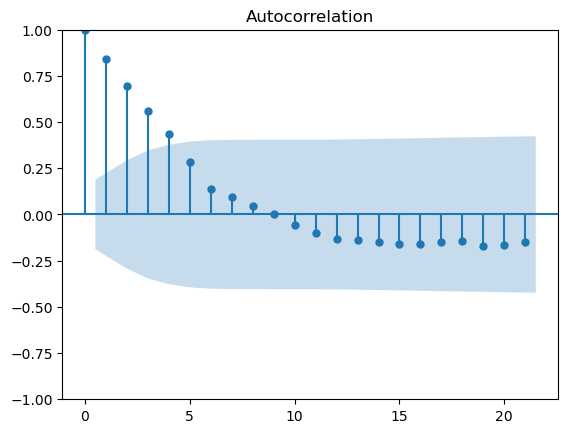

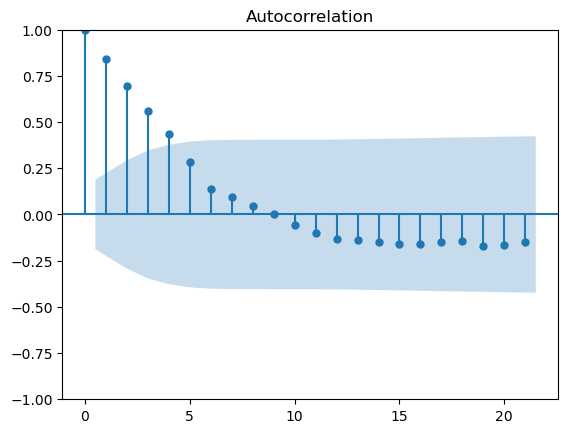

In [ ]:
# fix autocorr
acorr = sm.tsa.acf(result_OLS.resid, nlags=8)
print(acorr)
plot_acf(result_OLS.resid)


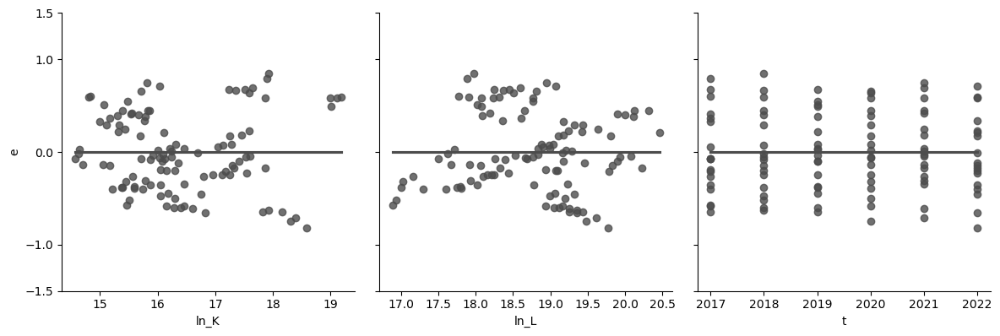

In [ ]:
X_resid = X.iloc[:, 1:]
X_resid = X_resid.join(pd.DataFrame({"e": result_OLS.resid}))
g = sns.PairGrid(X_resid, y_vars=["e"], x_vars=["ln_K", "ln_L", "t"], height=4)
g.map(sns.regplot, color=".3", ci=None)
g.set(ylim=(-1.5, 1.5), yticks=[-1.5, -1, 0, 1, 1.5])

In [ ]:
sm.stats.diagnostic.het_white(result_OLS.resid, X)

(24.41260092356057,
 0.0036945190326309815,
 3.1802173758552206,
 0.002057691131012841)

<Axes: >

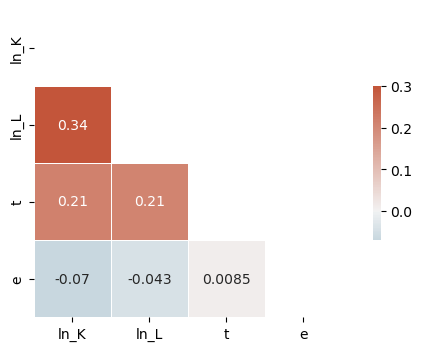

In [ ]:
corr = X_resid.corr('spearman')
corr.iloc[-1:, :-1]
mask = np.triu(np.ones_like(corr, dtype=bool))
plt.figure(figsize=(8,4))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

In [ ]:
spearman_rho = [stats.spearmanr(X_resid["e"], X_resid[col]) for col in X_resid.columns[:-1]]
spearman_rho

[SignificanceResult(statistic=-0.07003153372012155, pvalue=0.47139860505769415),
 SignificanceResult(statistic=-0.04288967008678918, pvalue=0.6594020127039137),
 SignificanceResult(statistic=0.008521467865340575, pvalue=0.9302511949629048)]

In [ ]:
e_squared = pd.DataFrame({'e^2': result_OLS.resid ** 2})

X_white_short = pd.DataFrame()
X_white_short["ln_K^2"] = X["ln_K"] ** 2
X_white_short["ln_L^2"] = X["ln_L"] ** 2
X_white_short["t^2"] = X["t"] ** 2
X_white_short = sm.add_constant(X_white_short)
X_white_short

,const,ln_K^2,ln_L^2,t^2
0,1.0,259.685774,349.133126,4068289
1,1.0,263.550546,352.277226,4072324
2,1.0,262.844547,354.845651,4076361
3,1.0,266.075435,356.461334,4080400
4,1.0,270.673092,360.703519,4084441
...,...,...,...,...
103,1.0,237.054665,315.009963,4072324
104,1.0,243.283470,316.595947,4076361
105,1.0,242.978673,316.985135,4080400
106,1.0,249.140507,321.392841,4084441


In [ ]:
regression = sm.OLS(e_squared, X_white_short, hasconst=True)
# regression = sm.OLS(e_squared, X_white_short.loc[:, ["const", "ln_K^2"]], hasconst=True)
result_OLS_resid = regression.fit()
print(result_OLS_resid.summary())

                            OLS Regression Results                            
Dep. Variable:                    e^2   R-squared:                       0.176
Model:                            OLS   Adj. R-squared:                  0.153
Method:                 Least Squares   F-statistic:                     7.429
Date:                Tue, 26 Dec 2023   Prob (F-statistic):           0.000148
Time:                        22:48:21   Log-Likelihood:                 42.305
No. Observations:                 108   AIC:                            -76.61
Df Residuals:                     104   BIC:                            -65.88
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.6319      9.767      0.986      0.3

In [ ]:
e_sq_pred = pd.Series(result_OLS_resid.fittedvalues)
regression = sm.WLS(Y, X, 1/e_sq_pred, hasconst=True)
result_WLS = regression.fit()
print(result_WLS.summary())

white_pvalue = sm.stats.diagnostic.het_white(result_WLS.resid, X)[1]
print('-- White\'s test pvalue: ', white_pvalue)

                            WLS Regression Results                            
Dep. Variable:                ln_ROFA   R-squared:                       0.846
Model:                            WLS   Adj. R-squared:                  0.841
Method:                 Least Squares   F-statistic:                     190.1
Date:                Tue, 26 Dec 2023   Prob (F-statistic):           4.62e-42
Time:                        22:48:21   Log-Likelihood:                -52.208
No. Observations:                 108   AIC:                             112.4
Df Residuals:                     104   BIC:                             123.1
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        214.9701     45.127      4.764      0.0

        ln_K       ln_L            t         e
0  37.959854  44.014521  4751.233272 -0.094132
1  38.681420  44.721126  4808.300563 -0.076847
2  40.193056  46.700474  5005.389354  0.012244
3  40.958090  47.407114  5072.110125  0.057497
4  41.772253  48.221481  5131.350391  0.018067


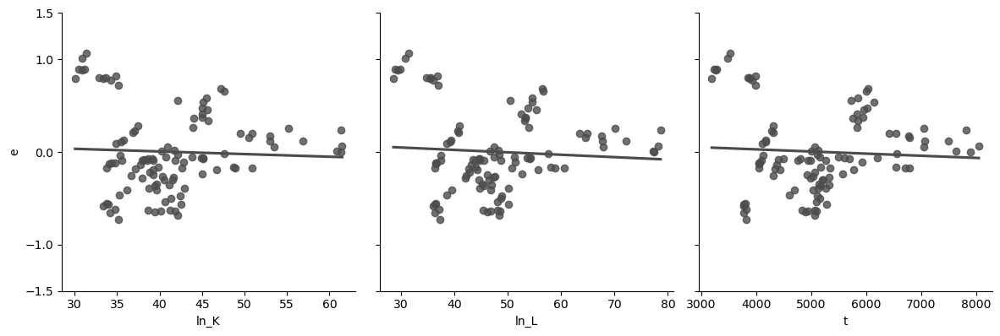

In [ ]:
X_resid = X.iloc[:, 1:]
X_resid = X_resid.join(pd.DataFrame({"e": result_WLS.resid}))
X_resid.loc[:, "ln_K":"t"] = X_resid.loc[:, "ln_K":"t"].divide(np.sqrt(e_sq_pred), axis=0)
print(X_resid.head())

g = sns.PairGrid(X_resid, y_vars=["e"], x_vars=["ln_K", "ln_L", "t"], height=4)
g.map(sns.regplot, color=".3", ci=None)
g.set(ylim=(-1.5, 1.5), yticks=[-1.5, -1, 0, 1, 1.5])